### Diabetes
Датасет: 70,692 ответа на опрос BRFSS 2015 (The Behavioral Risk Factor Surveillance System - это телефонный опрос, связанный со здоровьем, который проводится ежегодно). Датасет очищен.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import kagglehub

plt.style.use("ggplot")
pd.set_option("display.max_columns", 200)
sns.set_theme()

In [2]:
file_path = "diabetes_data.csv"

df = kagglehub.dataset_load(
    kagglehub.KaggleDatasetAdapter.PANDAS,
    "prosperchuks/health-dataset",
    file_path
)

Ссылка на датасет: https://www.kaggle.com/datasets/prosperchuks/health-dataset/data

In [3]:
df["Diabetes"].value_counts()

Diabetes
0.0    35346
1.0    35346
Name: count, dtype: int64

Классы сбалансированы

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70692 entries, 0 to 70691
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Age                   70692 non-null  float64
 1   Sex                   70692 non-null  float64
 2   HighChol              70692 non-null  float64
 3   CholCheck             70692 non-null  float64
 4   BMI                   70692 non-null  float64
 5   Smoker                70692 non-null  float64
 6   HeartDiseaseorAttack  70692 non-null  float64
 7   PhysActivity          70692 non-null  float64
 8   Fruits                70692 non-null  float64
 9   Veggies               70692 non-null  float64
 10  HvyAlcoholConsump     70692 non-null  float64
 11  GenHlth               70692 non-null  float64
 12  MentHlth              70692 non-null  float64
 13  PhysHlth              70692 non-null  float64
 14  DiffWalk              70692 non-null  float64
 15  Stroke             

#### Атрибуты

Пропусков нет.

Датасет состоит только из числовых атрибутов.

Имеются следующие атрибуты:
- **Age** - категория возраста

    Соответсвующие значения: 1 = 18-24, ... , 7 = 50-54, ... , 13 = 80 and above


- **Sex** - пол

    0 - женщины

    1 - мужчины

- **HighChol** - высокий холестерин

    0 - нет

    1 - да

- **CholCheck** - проверка уровня холестерина в течение 5 лет

    0 - нет

    1 - да
    
- **BMI** - индекс массы тела
    

- **Smoker** - Выкурил ли человек хотя бы 100 сигарет за всю жизнь? [5 пачек = 100 сигарет]

    0 - нет

    1 - да

- **HeartDiseaseorAttack** - ишемическая болезнь сердца или инфаркт миокарда

    0 - нет

    1 - да

- **PhysActivity** - физическая активность за последние 30 дней

    0 - нет

    1 - да

- **Fruits** - употребление фруктов 1 или более раз в день

    0 - нет

    1 - да
    
- **Veggies** - употребление овощей 1 или более раз в день

    0 - нет

    1 - да
    
- **HvyAlcoholConsump** - употребление алкоголя выше нормы (мужчины >= 14 и женщины >= 7 напитков в неделю)

    0 - нет

    1 - да
    
- **GenHlth** - здоровье в целом 

    Шкала: от 1 = отличное до 5 = плохое
    
- **MentHlth** - количество дней плохого психического здоровья
    
    Шкала: От 0 до 30
        
- **PhysHlth** - количество дней плохого физического здоровья

    Шкала: От 0 до 30
        
- **DiffWalk** - трудности при ходьбе

    0 - нет

    1 - да
        
- **Stroke** - инсульт

    0 - нет

    1 - да
        
- **HighBP** - Высокое давление

    0 - нет

    1 - да
          
- **Diabetes** - диабет

    0 - нет

    1 - да  


#### Описание статистик

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,70692.0,8.584055,2.852153,1.0,7.0,9.0,11.0,13.0
Sex,70692.0,0.456997,0.498151,0.0,0.0,0.0,1.0,1.0
HighChol,70692.0,0.525703,0.499342,0.0,0.0,1.0,1.0,1.0
CholCheck,70692.0,0.975259,0.155336,0.0,1.0,1.0,1.0,1.0
BMI,70692.0,29.856985,7.113954,12.0,25.0,29.0,33.0,98.0
Smoker,70692.0,0.475273,0.499392,0.0,0.0,0.0,1.0,1.0
HeartDiseaseorAttack,70692.0,0.147810,0.354914,0.0,0.0,0.0,0.0,1.0
PhysActivity,70692.0,0.703036,0.456924,0.0,0.0,1.0,1.0,1.0
Fruits,70692.0,0.611795,0.487345,0.0,0.0,1.0,1.0,1.0
Veggies,70692.0,0.788774,0.408181,0.0,1.0,1.0,1.0,1.0


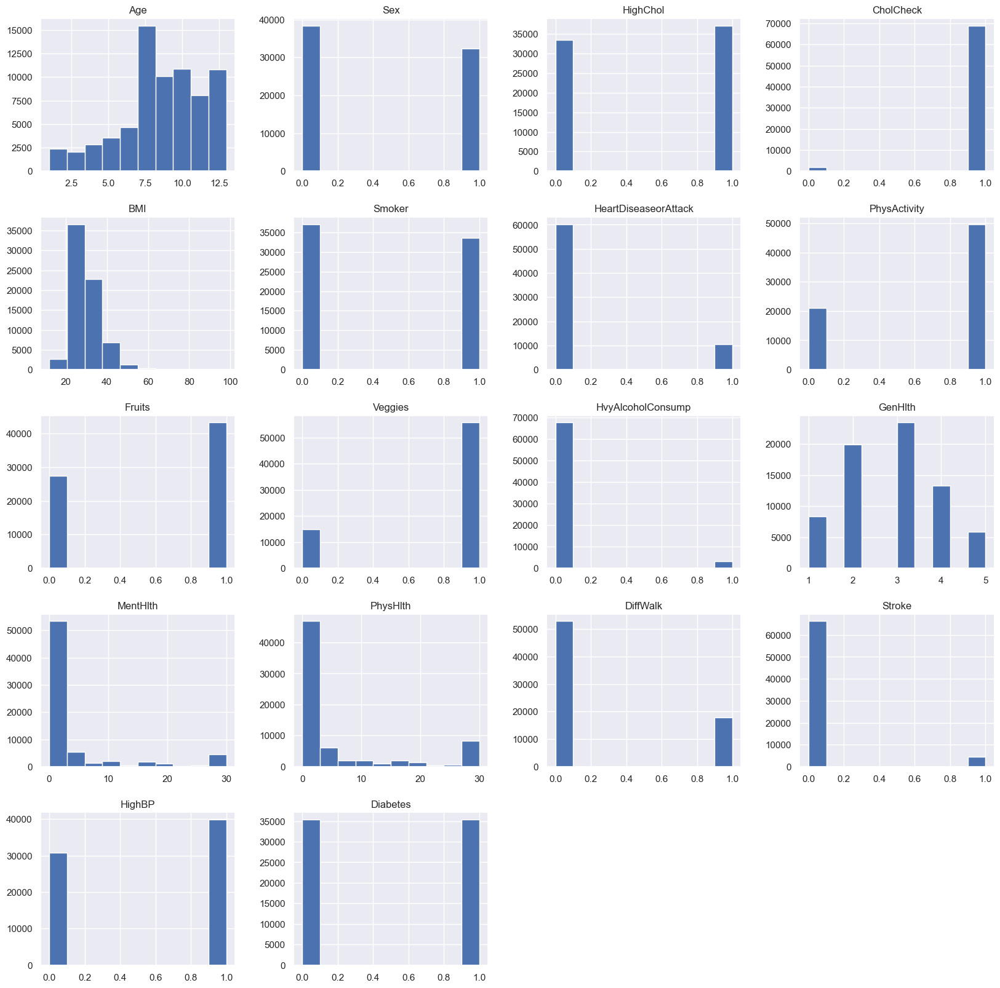

In [6]:
df.hist(figsize=(20,20))
plt.show()

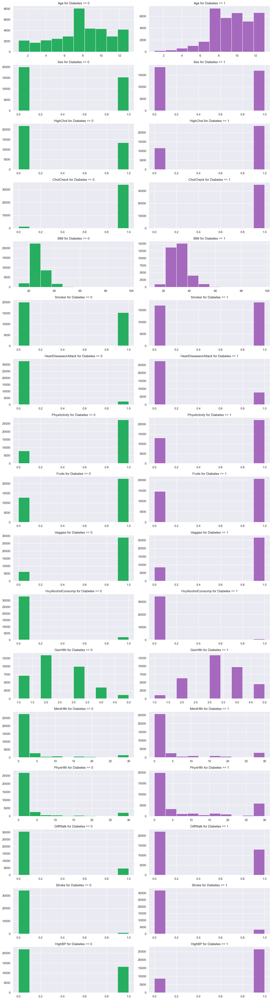

In [ ]:
hist_columns = [col for col in df.columns if col != "Diabetes"]
n = len(hist_columns)
fig, axes = plt.subplots(n, 2, figsize=(14, n * 3))

for i, col in enumerate(hist_columns):
    axes[i, 0].hist(df[df["Diabetes"] == 0][col], color="#27ae60")
    axes[i, 0].set_title(f"{col} for Diabetes == 0")
    
    axes[i, 1].hist(df[df["Diabetes"] == 1][col], color="#a569bd")
    axes[i, 1].set_title(f"{col} for Diabetes == 1")

plt.tight_layout()
plt.show()

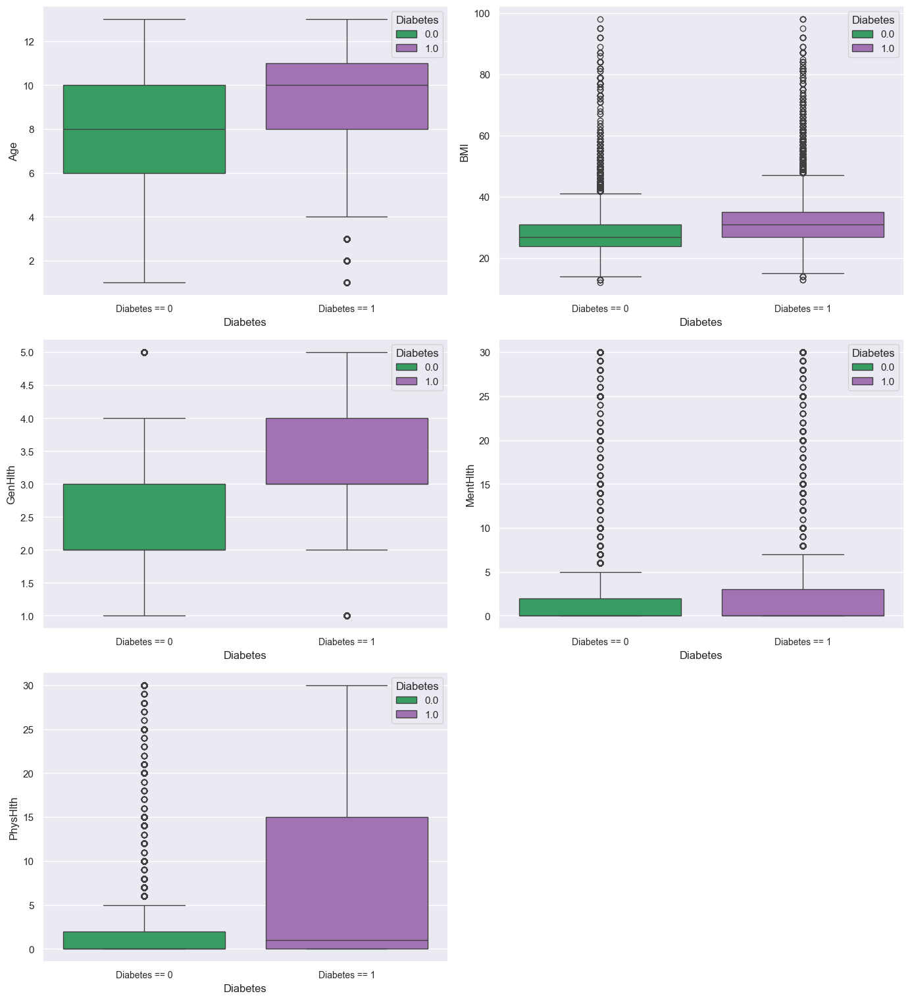

In [34]:
include_columns = ["Age", "BMI", "MentHlth", "PhysHlth", "GenHlth"]
box_columns = [col for col in df.columns if col in include_columns]

plt.figure(figsize=(14, len(box_columns) * 5))

for idx, column in enumerate(box_columns, 1):
    plt.subplot(len(box_columns), 2, idx)
    sns.boxplot(x="Diabetes", y=column, data=df, hue="Diabetes", palette={0: "#27ae60", 1: "#a569bd"})
    plt.xlabel("Diabetes")
    plt.ylabel(column)
    plt.xticks([0, 1], ["Diabetes == 0", "Diabetes == 1"], fontsize=10)

plt.tight_layout()
plt.show()

- Age

Группа с диабетом выглядит старше, медиана смещена выше, верхний квартиль выше, чем у группы без диабета. Риск диабета растёт с возрастом.

- BMI

У людей с диабетом медиана BMI либо немного выше, либо находится на схожем уровне, можно заметить много выбросов, уходящих к более высоким значениям.
Среди диабетиков чаще встречается повышенный BMI по сравнению с группой без диабета. Лишний вес является одним из факторов риска диабета

- GenHlth

У людей с диабетом значения выше - оценка здоровья хуже. Медиана ближе к 3 (удовлетворительное), в то время как у людей без диабета - ниже, ближе к 2 (хорошее). Диапазон значений у диабетиков шире, но есть и выбросы в сторону лучших значений - возможно, не у всех болезнь приводит к ухудшению самочувствия.

- MentHlth

В группе с диабетом разброс больше, есть выбросы. Это может означать, что у некоторых пациентов с диабетом бывают более частые проблемы с ментальным здоровьем.
Нельзя сказать, что все диабетики имеют сильные проблемы с ментальным здоровьем, но вероятность этого выше.

- PhysHlth

У группы с диабетом медиана заметно выше, а значит, они чаще испытывают физические недомогания или ограничения.
Есть выбросы - некоторые пациенты с очень высоким числом тяжелых дней.


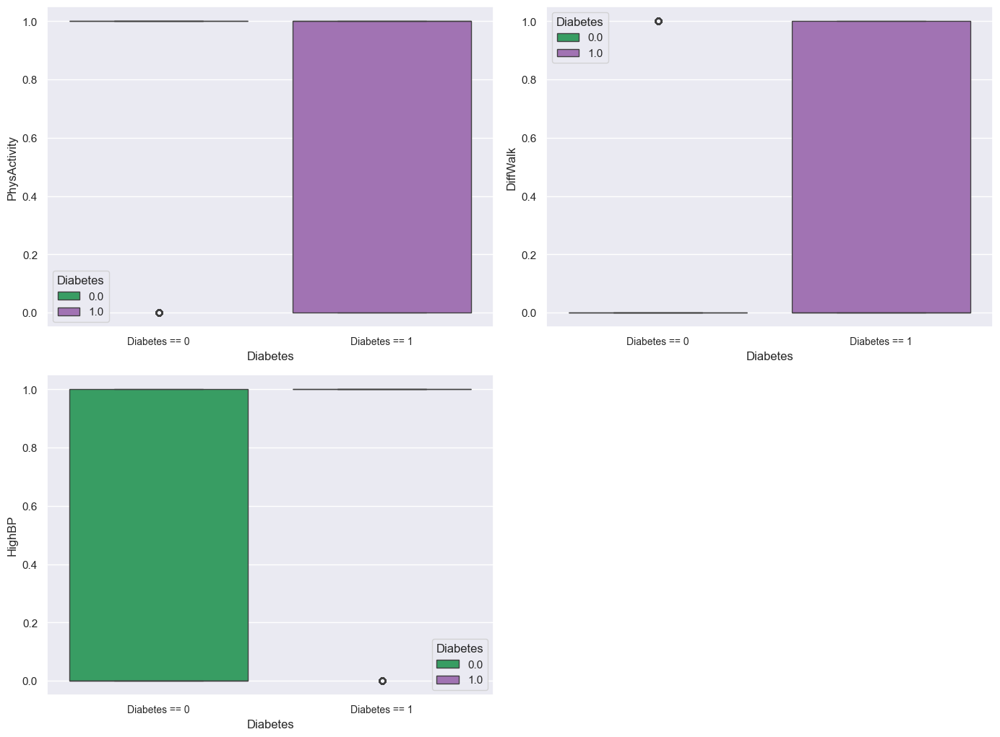

In [33]:
include_columns = ["PhysActivity", "DiffWalk", "HighBP"]
box_columns = [col for col in df.columns if col in include_columns]

plt.figure(figsize=(14, len(box_columns) * 5))

for idx, column in enumerate(box_columns, 1):
    plt.subplot(len(box_columns), 2, idx)
    sns.boxplot(x="Diabetes", y=column, data=df, hue="Diabetes", palette={0: "#27ae60", 1: "#a569bd"})
    plt.xlabel("Diabetes")
    plt.ylabel(column)
    plt.xticks([0, 1], ["Diabetes == 0", "Diabetes == 1"], fontsize=10)

plt.tight_layout()
plt.show()

Люди с диабетом реже занимаются физической активностью, чаще испытывают трудности при ходьбе, чаще страдают высоким давлением.

(остально не информативно?)

In [20]:
# Колонки с двумя возможными значениями ()
binary_columns = [
    "Sex", 
    "HighChol", 
    "CholCheck", 
    "Smoker", 
    "HeartDiseaseorAttack", 
    "PhysActivity", 
    "Fruits", 
    "Veggies", 
    "HvyAlcoholConsump", 
    "DiffWalk", 
    "Stroke", 
    "HighBP",
    "Diabetes",
]

# Колонки, которые не надо разбрасывать
not_touchable_columns = [
    "BMI",
    "MentHlth",
    "PhysHlth",
]

df_scattered = df.copy()
for column in df_scattered.columns:
    deviation_coef = 0.2 if column in binary_columns else 0.07
    if column not in not_touchable_columns:
        df_scattered[column] += np.random.normal(0, deviation_coef * df_scattered[column].std(), len(df_scattered))

# Расчет корреляций
corr = df.corr()

C:\Users\Yana\AppData\Local\Temp\ipykernel_14400\2391806518.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f, ax = plt.subplots(1, 2)


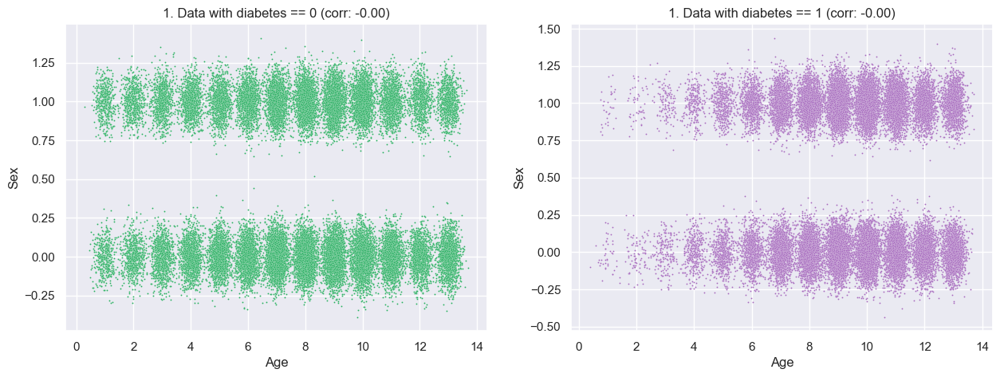

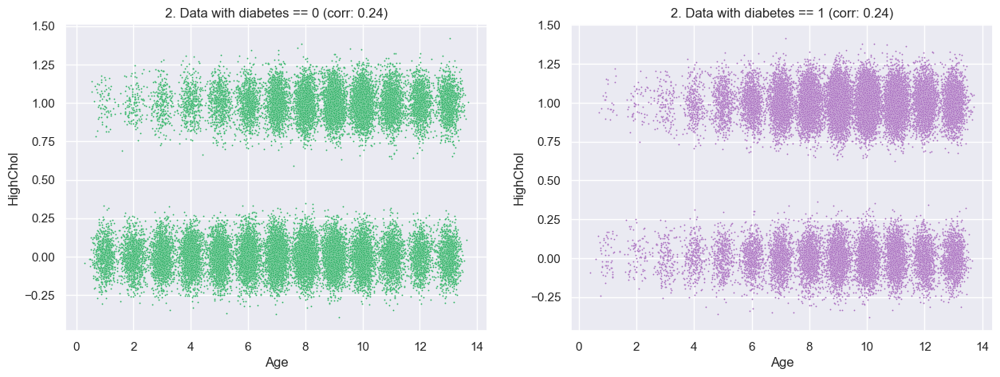

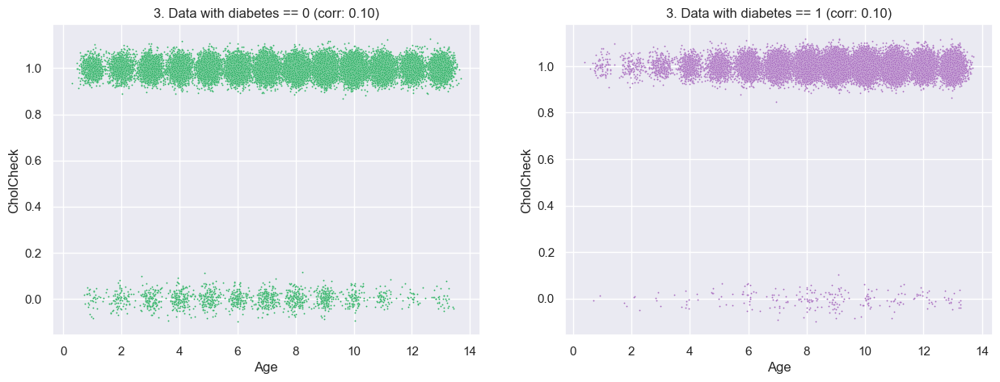

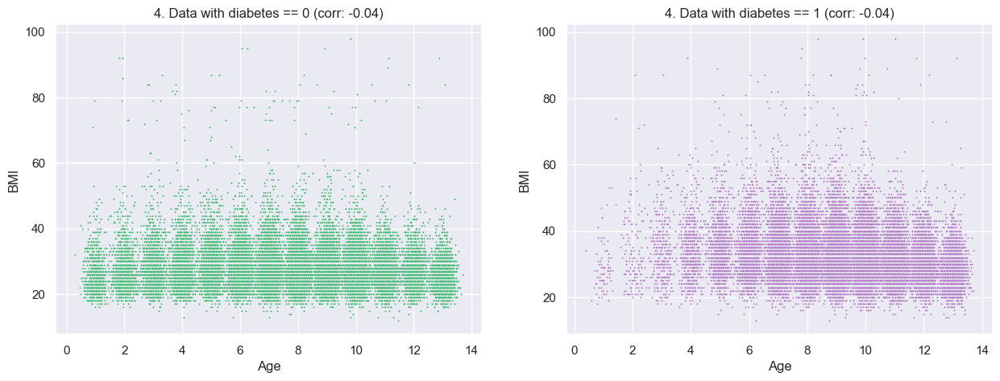

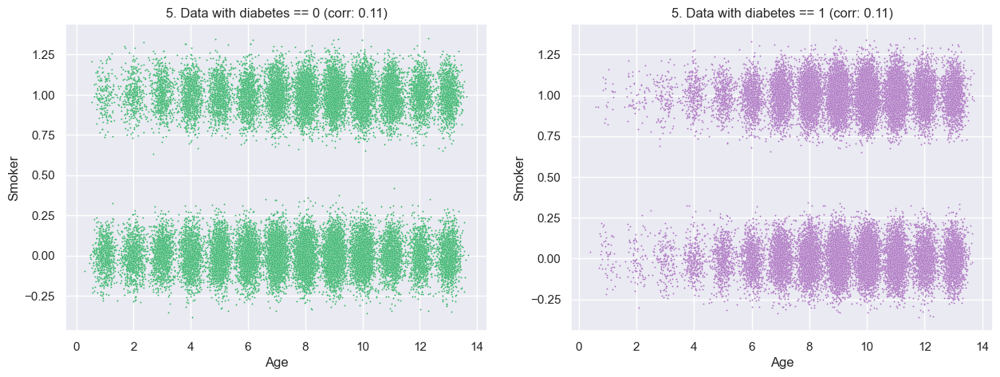

...

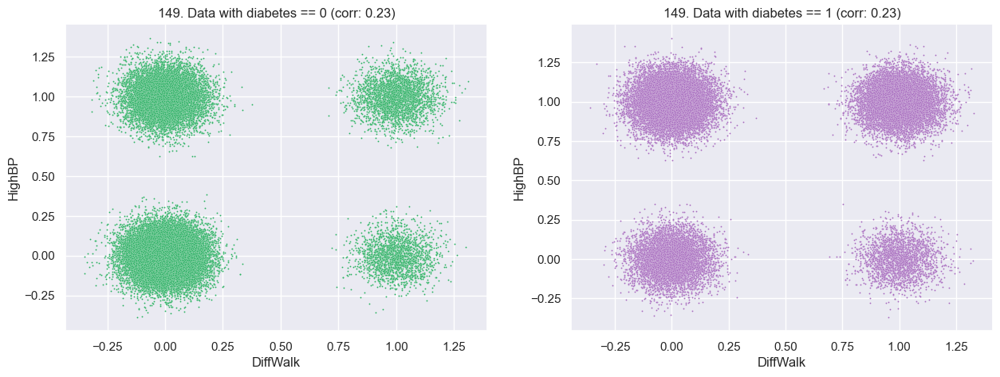

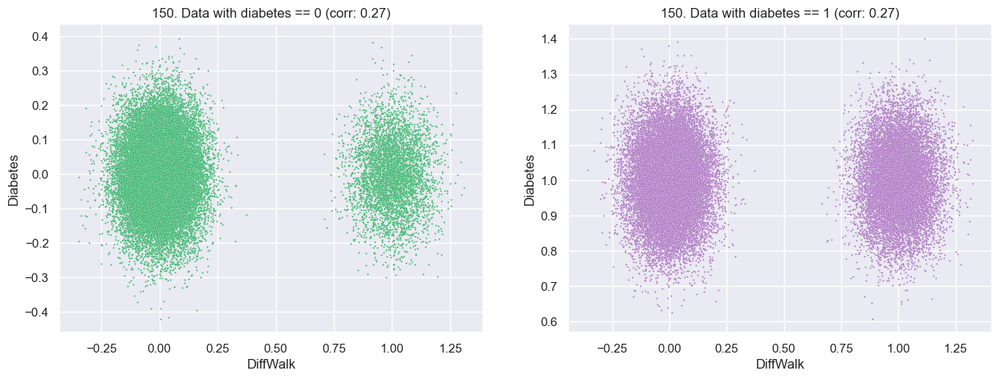

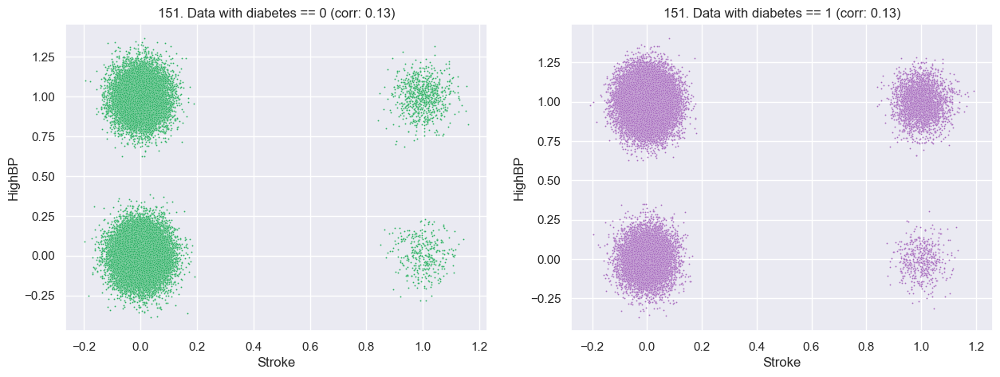

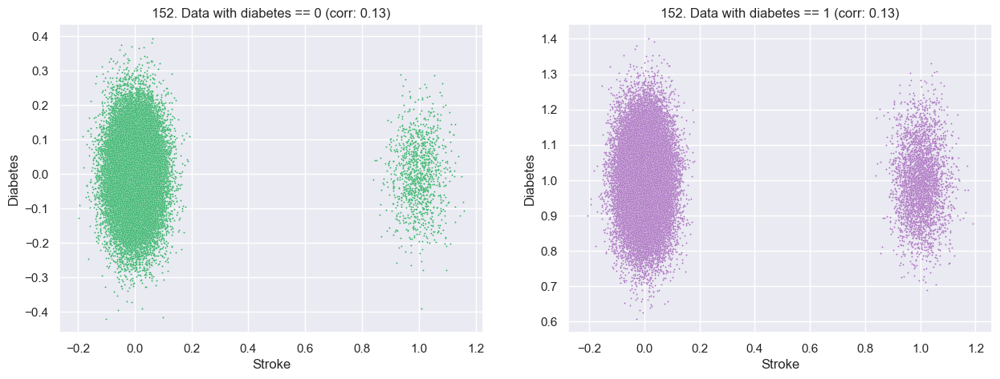

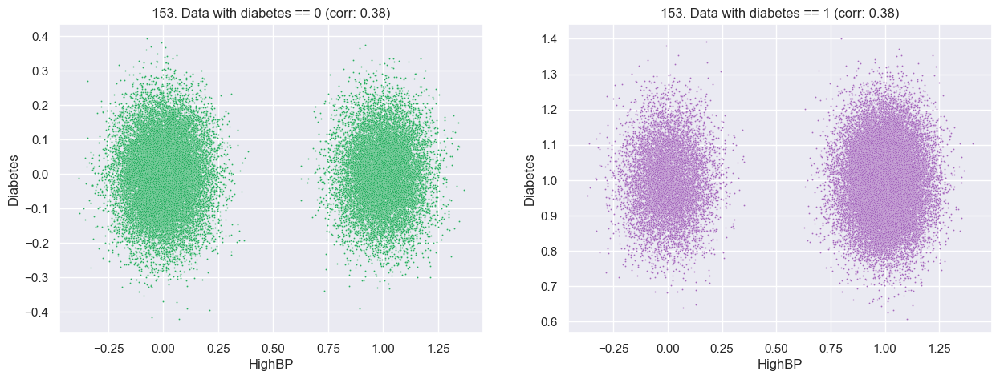

In [29]:
columns = df_scattered.columns
df_scattered_diabetes_0 = df_scattered.loc[df["Diabetes"] == 0]
df_scattered_diabetes_1 = df_scattered.loc[df["Diabetes"] == 1]
counter = 1
for i in range(len(columns) - 1):
    for j in range(i + 1, len(columns)):
        f, ax = plt.subplots(1, 2)
        f.set_size_inches(15, 5)
        ax[0].set_title(f"{counter}. Data with diabetes == 0 (corr: {corr[columns[i]][columns[j]]:.2f})")
        ax[1].set_title(f"{counter}. Data with diabetes == 1 (corr: {corr[columns[i]][columns[j]]:.2f})")
        sns.scatterplot(x=df_scattered_diabetes_0[columns[i]], y=df_scattered_diabetes_0[columns[j]], s=2, alpha=1, color="#27ae60", ax=ax[0]) 
        sns.scatterplot(x=df_scattered_diabetes_1[columns[i]], y=df_scattered_diabetes_1[columns[j]], s=2, alpha=1, color="#a569bd", ax=ax[1])
        counter += 1 

*да, очень много графиков*

Что можно увидеть?

- Age

У молодых людей реже встречается диабет. Люди с диабетом употребляют меньше алгоколя. У людей с диабетом чаще появляются серьезные заболевания сердца и высокое давление.

- Sex

Симптомы диабета и другие факторы почти не зависят от пола.

- HighChol

Повышенный холестерин чаща встречается у людей, у которых есть проблемы со здоровьем. (очень интересное наблюдение)

- CholCheck

Люди с диабетом и повышенным BMI и другими проблемами чаще проверяются на повышенный холестерин.

- BMI

У людей, которым трудно ходить, чаще встречается повышенный BMI, если у них есть диабет, чем если бы диабета не было. (график 72)


<Axes: >

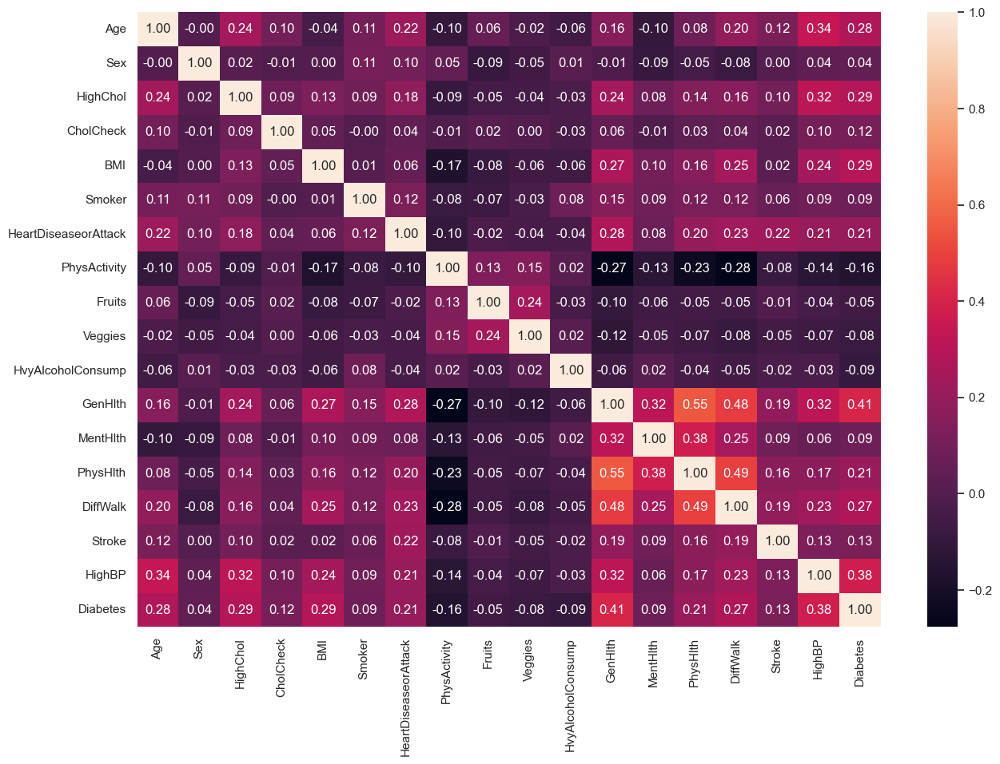

In [21]:
plt.figure(figsize=(15, 10))
sns.heatmap(corr, annot=True, fmt=".2f")

<Axes: >

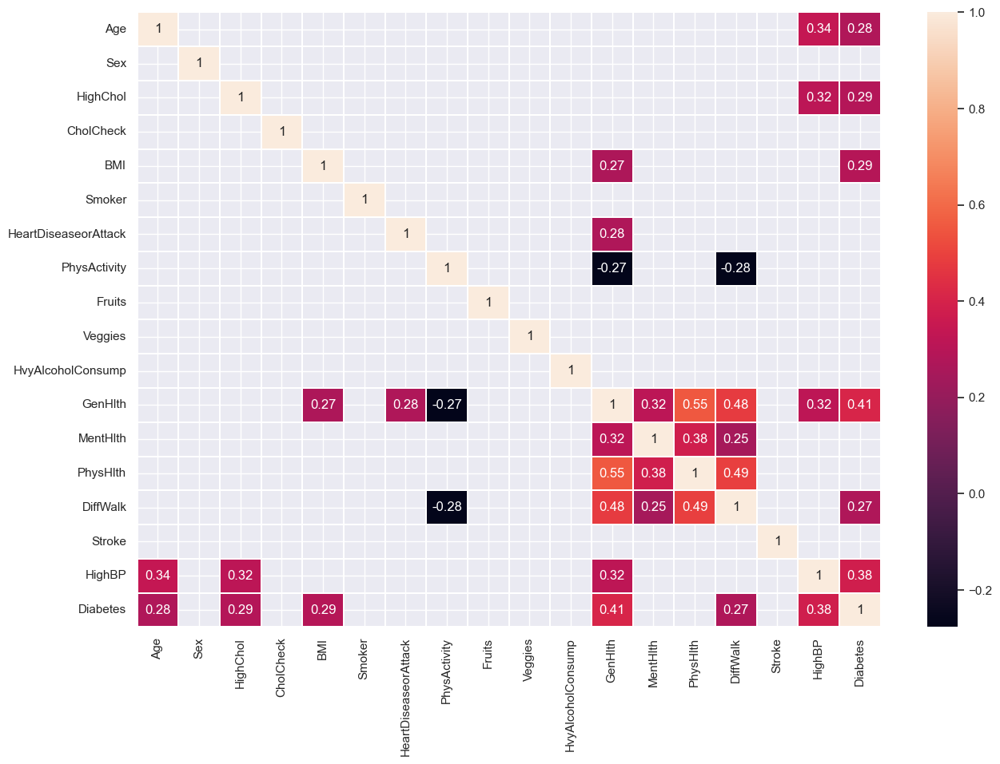

In [ ]:
plt.figure(figsize=(15, 10))
sns.heatmap(corr[(corr >= 0.25) | (corr <= -0.25)], annot=True, linewidths=0.01)

Что можно заметить?
* Слабо-средняя корреляция 

Age и Diabetes = 

* Средняя корреляция 

Age и HighBP = 
